<a href="https://colab.research.google.com/github/hallpaz/3dsystems23/blob/main/assignments/lab12_differentiable_rendering_demo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
import sys
import torch
need_pytorch3d=False
try:
    import pytorch3d
except ModuleNotFoundError:
    need_pytorch3d=True
if need_pytorch3d:
    if torch.__version__.startswith(("1.13.", "2.0.")) and sys.platform.startswith("linux"):
        # We try to install PyTorch3D via a released wheel.
        pyt_version_str=torch.__version__.split("+")[0].replace(".", "")
        version_str="".join([
            f"py3{sys.version_info.minor}_cu",
            torch.version.cuda.replace(".",""),
            f"_pyt{pyt_version_str}"
        ])
        !pip install fvcore iopath
        !pip install --no-index --no-cache-dir pytorch3d -f https://dl.fbaipublicfiles.com/pytorch3d/packaging/wheels/{version_str}/download.html
    else:
        # We try to install PyTorch3D from source.
        !pip install 'git+https://github.com/facebookresearch/pytorch3d.git@stable'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 2.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 kB 5.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for fvcore: filename=fvcore-0.1.5.post20221221-py3-none-any.whl size=61405 sha256=2b0c06fae835ff9b82d8d23f5ddcb85f2c20fc6951aa834a2da6056bab00c679
  Stored in directory: /root/.cache/pip/wheels/01/c0/af/77c1cf53a1be9e42a52b48e5af2169d40ec2e89f7362489dd0
  Created wheel for iopath: filename=iopath-0.1.10-py3-none-any.whl size=31531 sha256=316e58986a38f1bceb366b363d7e4477fe6b91a5ab4197ececd69bf89443e570
  Stored in directory: /root/.cache/pip/wheels/9a/a3/b6/ac0fcd1b4ed5cfeb3db92e6a0e476cfd48ed0df92b91080c1d
Successfully built fvcore iopath
Looking in links: https://dl.fbaipublicfiles.com/pytorch3d/packaging/wheels/py310_cu118_pyt201/dow

In [ ]:
import os
import torch
import matplotlib.pyplot as plt
import numpy as np

from skimage.io import imread

# Util function for loading meshes
from pytorch3d.io import load_objs_as_meshes, load_obj

# Data structures and functions for rendering
from pytorch3d.structures import Meshes
from pytorch3d.vis.plotly_vis import AxisArgs, plot_batch_individually, plot_scene
from pytorch3d.vis.texture_vis import texturesuv_image_matplotlib
from pytorch3d.renderer import (
    look_at_view_transform,
    FoVPerspectiveCameras,
    PointLights,
    DirectionalLights,
    Materials,
    RasterizationSettings,
    MeshRenderer,
    MeshRasterizer,
    SoftPhongShader,
    TexturesUV,
    TexturesVertex,
    TexturesAtlas
)

# add path for demo utils functions
import sys
import os
sys.path.append(os.path.abspath(''))

In [ ]:
# Setup
if torch.cuda.is_available():
    device = torch.device("cuda:0")
    torch.cuda.set_device(device)
else:
    device = torch.device("cpu")

In [ ]:
# Initialize a camera.
# With world coordinates +Y up, +X left and +Z in, the front of the cow is facing the -Z direction.
# So we move the camera by 180 in the azimuth direction so it is facing the front of the cow.
R, T = look_at_view_transform(2.7, 0, 180)
cameras = FoVPerspectiveCameras(device=device, R=R, T=T)

# Define the settings for rasterization and shading. Here we set the output image to be of size
# 512x512. As we are rendering images for visualization purposes only we will set faces_per_pixel=1
# and blur_radius=0.0. We also set bin_size and max_faces_per_bin to None which ensure that
# the faster coarse-to-fine rasterization method is used. Refer to rasterize_meshes.py for
# explanations of these parameters. Refer to docs/notes/renderer.md for an explanation of
# the difference between naive and coarse-to-fine rasterization.
raster_settings = RasterizationSettings(
    image_size=512,
    blur_radius=0.0,
    faces_per_pixel=1,
)

# Place a point light in front of the object. As mentioned above, the front of the cow is facing the
# -z direction.
lights = PointLights(device=device, location=[[0.0, 0.0, -3.0]])

# Create a phong renderer by composing a rasterizer and a shader. The textured phong shader will
# interpolate the texture uv coordinates for each vertex, sample from a texture image and
# apply the Phong lighting model
renderer = MeshRenderer(
    rasterizer=MeshRasterizer(
        cameras=cameras,
        raster_settings=raster_settings
    ),
    shader=SoftPhongShader(
        device=device,
        cameras=cameras,
        lights=lights
    )
)

# Experimenting with renderer's parameters

In [ ]:
# Vertex coordinates for a level 0 cube.
cube_verts = [
    [-0.50, 0.50, 0.50],
    [-0.50, -0.50, 0.50],
    [0.50, -0.50, 0.50],
    [0.50, 0.50, 0.50],

    [-0.50, 0.50, -0.50],
    [-0.50, -0.50, -0.50],
    [0.50, -0.50, -0.50],
    [0.50, 0.50, -0.50]
]

cube_faces = [
    [0, 1, 2], [2, 3, 0],
    [6, 3, 2], [3, 6, 7],
    [3, 4, 0], [4, 3, 7],
    [7, 6, 5], [4, 7, 5],
    [4, 5, 0], [0, 5, 1],
    [2, 1, 5], [5, 6, 2],
]

cs = [[1, 1, 0], [1, 0, 0], [0, 0, 1], [0, 1, 1], [1, 0, 1], [0, 1, 0]]
face_colors = []
for color in cs:
  face_colors.append(color)
  face_colors.append(color)
print(len(face_colors), len(cube_faces))
face_colors = torch.Tensor(face_colors)   # (F, 3)  --> (R,G,B)  and each value is in 0~1
face_colors = face_colors[None, :, None, None, :]   # (1, F, 1, 1, 3)
print(face_colors.shape)

atextures = TexturesAtlas(atlas=face_colors)

cube_mesh = Meshes([torch.Tensor(cube_verts)],
                   [torch.Tensor(cube_faces)], atextures).to(device)

12 12
torch.Size([1, 12, 1, 1, 3])


In [ ]:
R, T = look_at_view_transform(2.7, 30, 45)
cameras = FoVPerspectiveCameras(device=device, R=R, T=T)
lights = PointLights(device=device, location=[[0.0, 0.0, 3.0]])

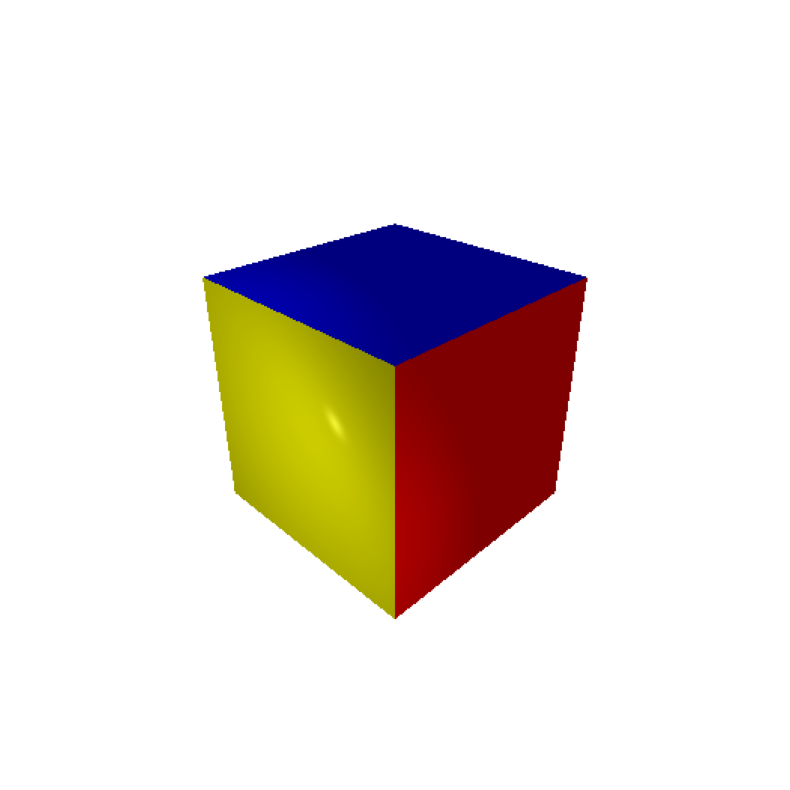

In [ ]:
images = renderer(cube_mesh, cameras=cameras, lights=lights)
plt.figure(figsize=(10, 10))
plt.imshow(images[0, ..., :3].cpu().numpy())
plt.grid("off");
plt.axis("off");

# Changing the Blur radius

In [ ]:
bradius = [0, 0.0001, 0.0005, 0.001, 0.002]
blur_renderers = []
for radius in bradius:
  raster_settings = RasterizationSettings(
    image_size=512, blur_radius=radius, faces_per_pixel=1
  )
  renderer = MeshRenderer(
      rasterizer=MeshRasterizer(raster_settings=raster_settings),
      shader=SoftPhongShader(device=device)
  )
  blur_renderers.append(renderer)

1


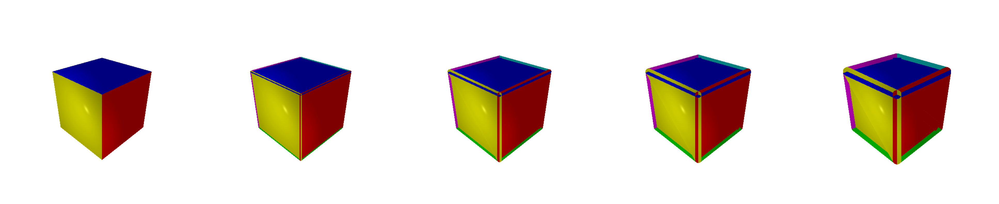

In [ ]:
bimages = []
for mrenderer in blur_renderers:
  img = mrenderer(cube_mesh, cameras=cameras, lights=lights)
  bimages.append(img[0].detach().cpu().numpy())

print(len(images))
plt.figure(figsize=(10 * len(bimages), 10))
plt.imshow(np.hstack(bimages)[..., 0:3])
plt.grid("off");
plt.axis("off");

# Changing the number of faces per pixel

In [ ]:
fpps = [1, 2, 5, 10, 100]
agg_renderers = []
for fpp in fpps:
  raster_settings = RasterizationSettings(
    image_size=512, blur_radius=0.001, faces_per_pixel=fpp,
    bin_size=0, max_faces_per_bin=1000
  )
  renderer = MeshRenderer(
      rasterizer=MeshRasterizer(raster_settings=raster_settings),
      shader=SoftPhongShader(device=device)
  )
  agg_renderers.append(renderer)

5


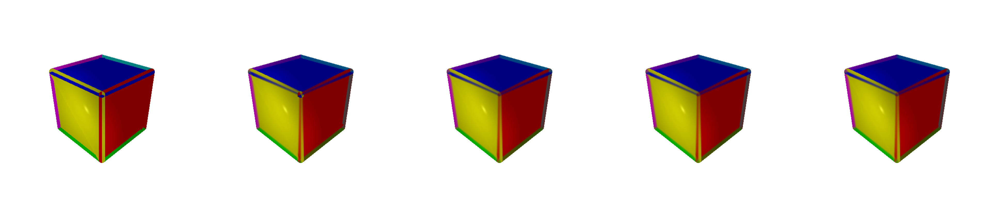

In [ ]:
fimages = []
for mrenderer in agg_renderers:
  img = mrenderer(cube_mesh, cameras=cameras, lights=lights)
  fimages.append(img[0].detach().cpu().numpy())

print(len(fimages))
plt.figure(figsize=(10 * len(fimages), 10))
plt.imshow(np.hstack(fimages)[..., 0:3])
plt.grid("off");
plt.axis("off");

# Optimizing with Pulsar Backend

In [ ]:
import numpy as np

from pytorch3d.structures import Pointclouds
from pytorch3d.renderer import (
    FoVOrthographicCameras,
    PointsRasterizationSettings,
    PointsRenderer,
    PulsarPointsRenderer,
    PointsRasterizer,
    AlphaCompositor,
    NormWeightedCompositor
)

In [ ]:
from PIL import Image
from tqdm.notebook import tqdm

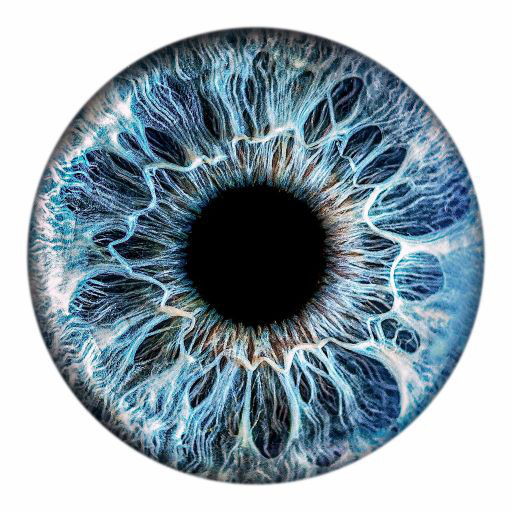

In [ ]:
Image.open("/content/eye.jpg")

In [ ]:
gt = torch.from_numpy(np.array(Image.open("/content/eye.jpg"))) / 255
gt = gt.to(device)

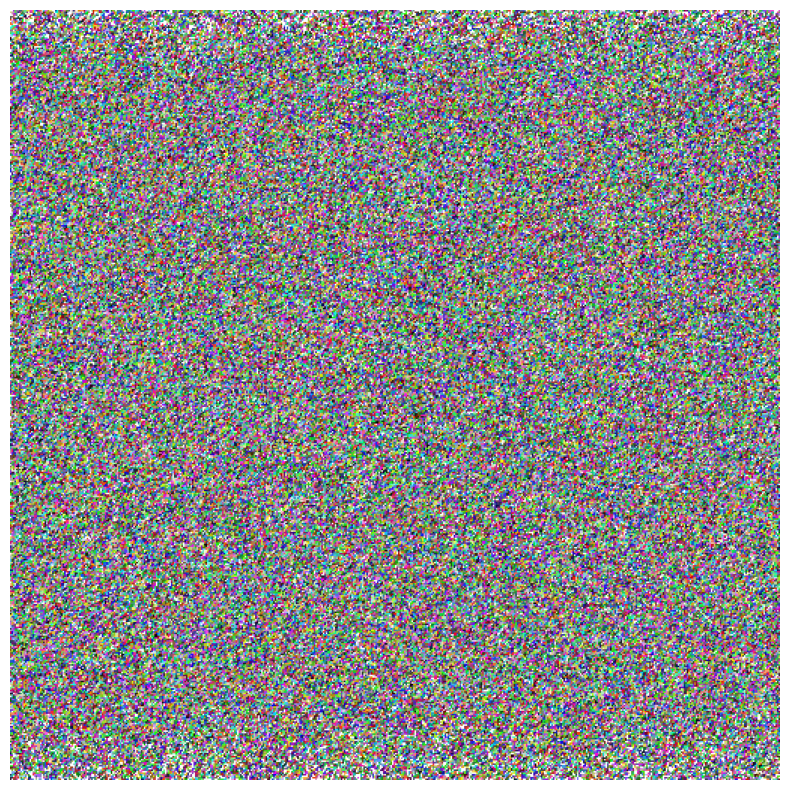

In [ ]:
torch.manual_seed(777)
npoints = 400000
raster_settings = PointsRasterizationSettings(
    image_size=512,
    radius = 0.003,
    points_per_pixel = 10
)
R, T = look_at_view_transform(20, 10, 0)
cameras = FoVOrthographicCameras(device=device, R=R, T=T, znear=0.01)
pcrenderer = PulsarPointsRenderer(
    rasterizer=PointsRasterizer(cameras=cameras, raster_settings=raster_settings),
    n_channels=3
).to(device)

with torch.no_grad():
  verts = torch.rand([npoints, 3], requires_grad=True)
  verts = (verts - 0.5) * 2
  rgb = torch.rand([npoints, 3], requires_grad=True)
  point_cloud = Pointclouds(points=[verts], features=[rgb]).to(device)
  images = pcrenderer(point_cloud, gamma=(1e-4,),
                    bg_col=torch.tensor([1.0, 1.0, 1.0], dtype=torch.float32, device=device))
  plt.figure(figsize=(10, 10))
  plt.imshow(images[0, ..., :3].cpu().numpy())
  plt.grid("off")
  plt.axis("off");

  0%|          | 0/2501 [00:00<?, ?it/s]

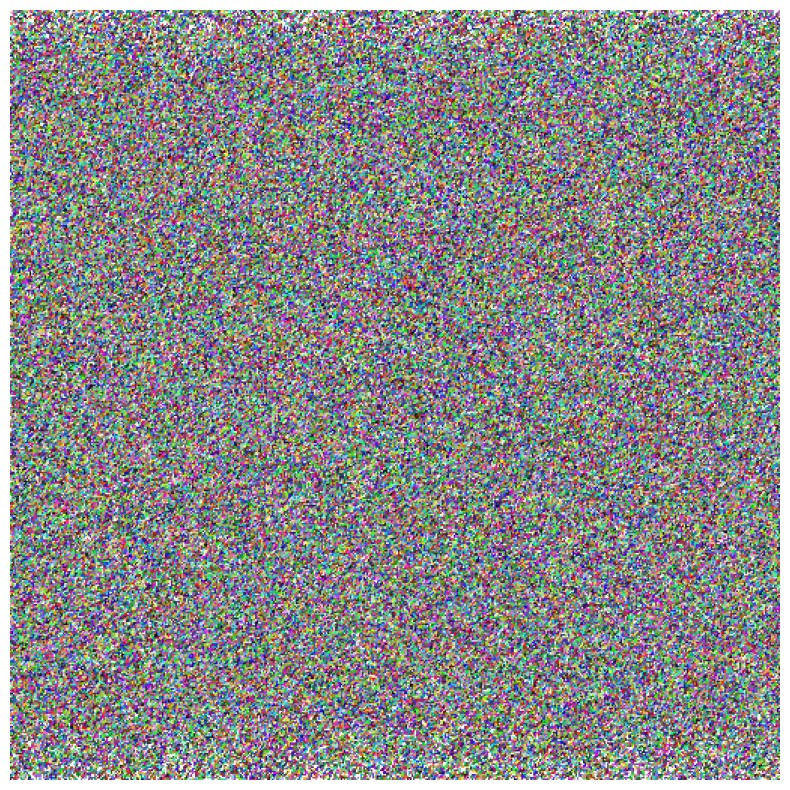

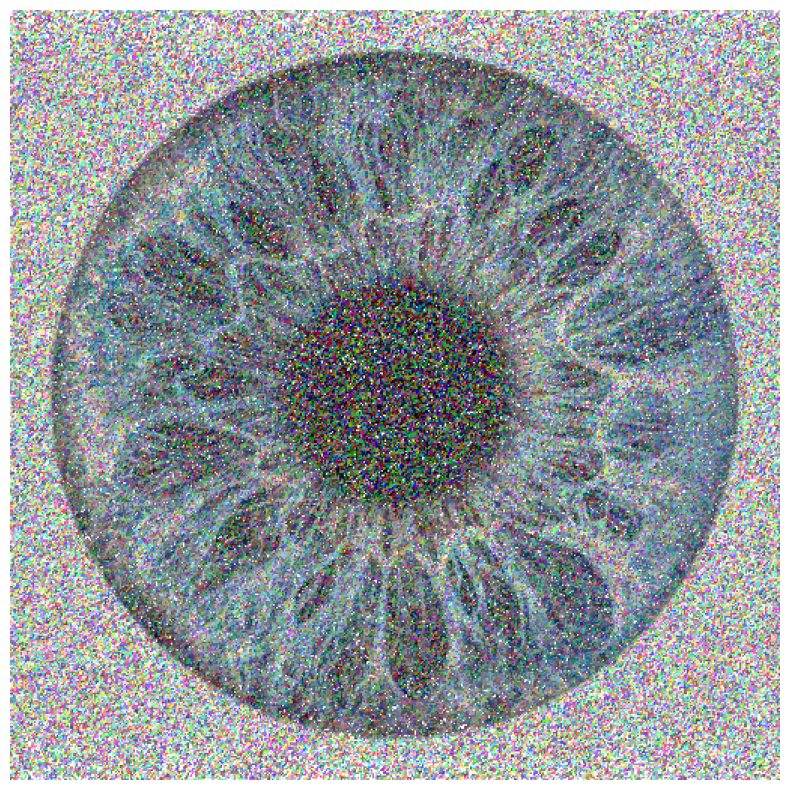

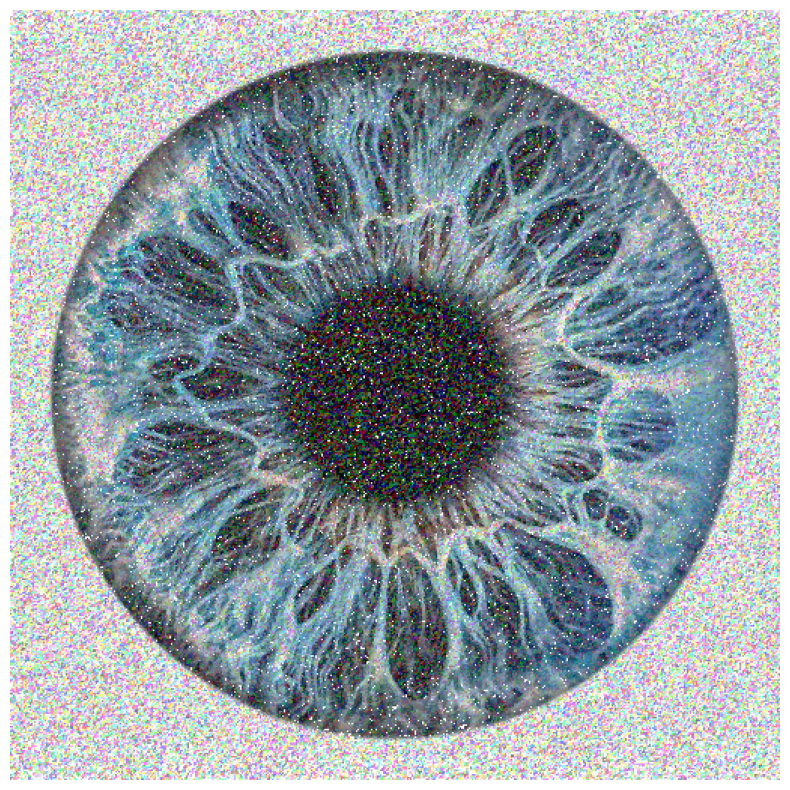

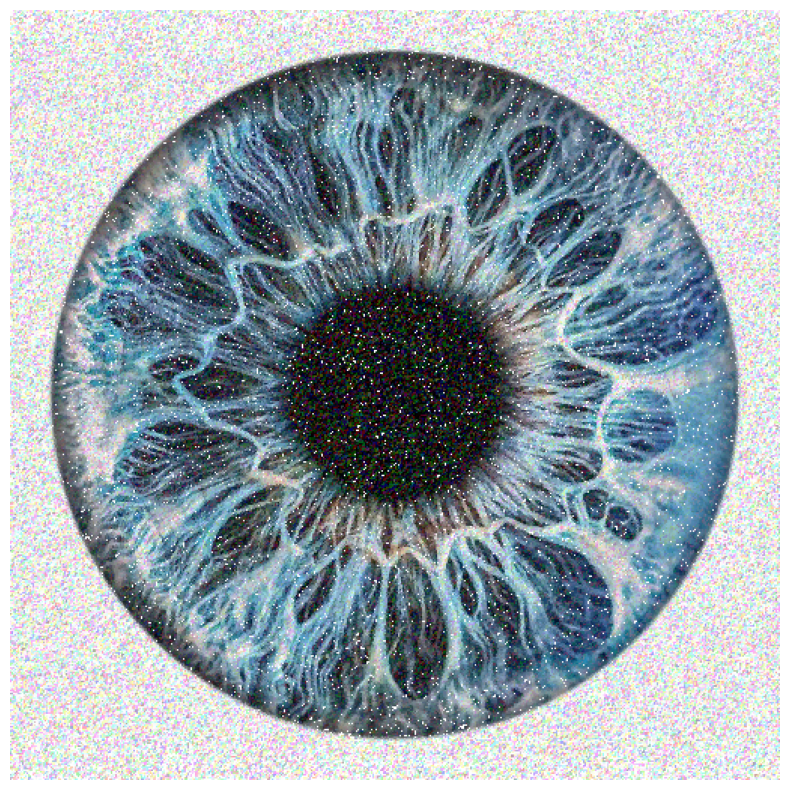

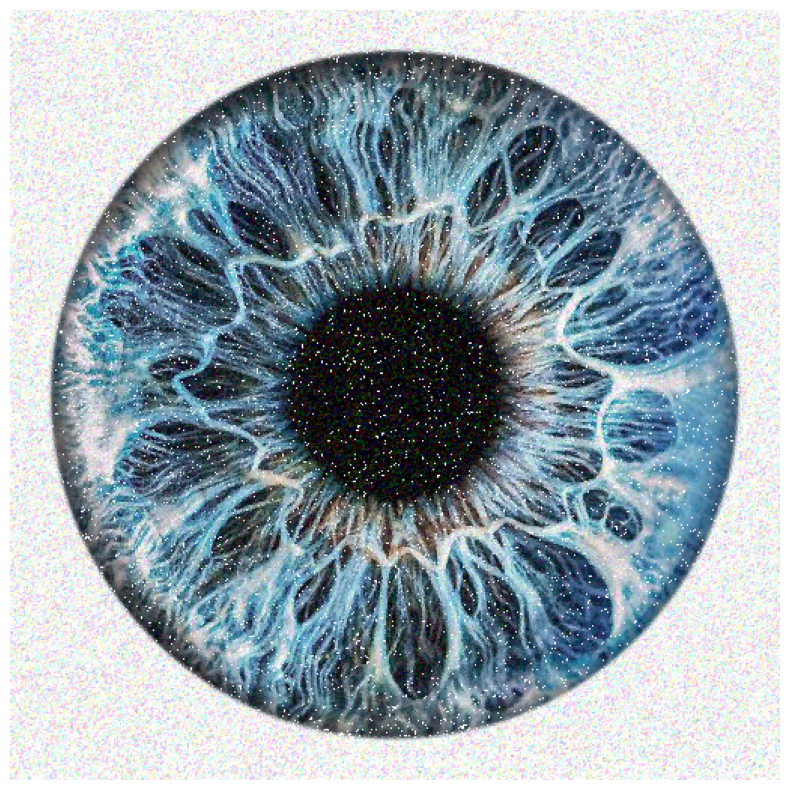

...

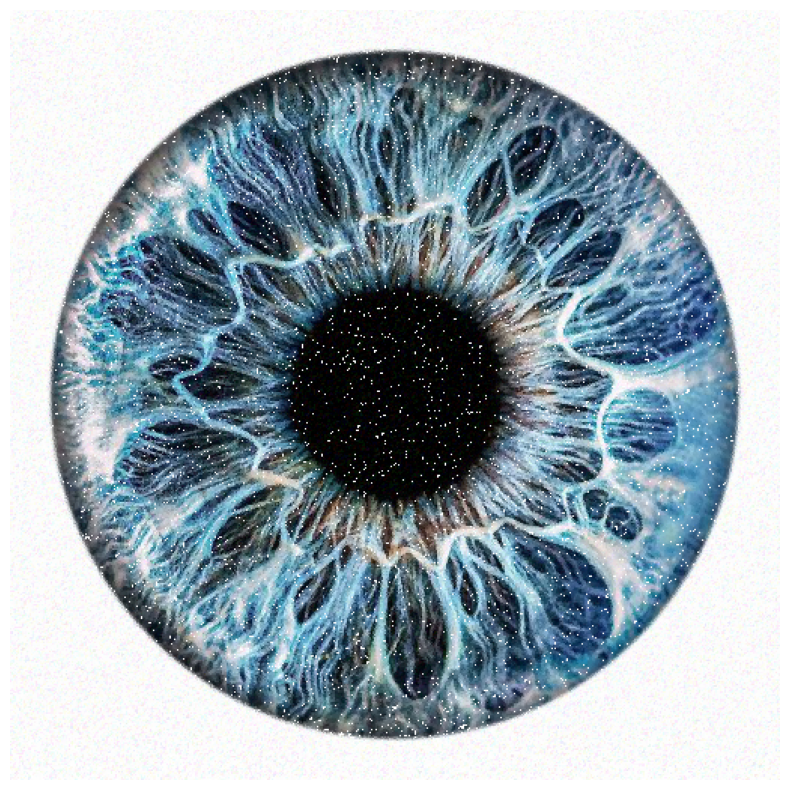

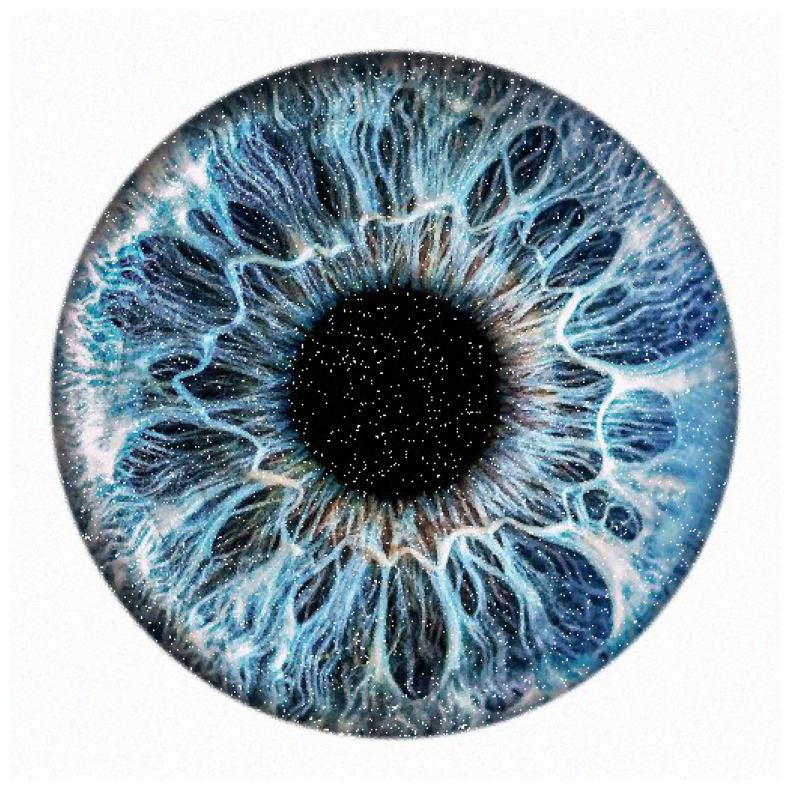

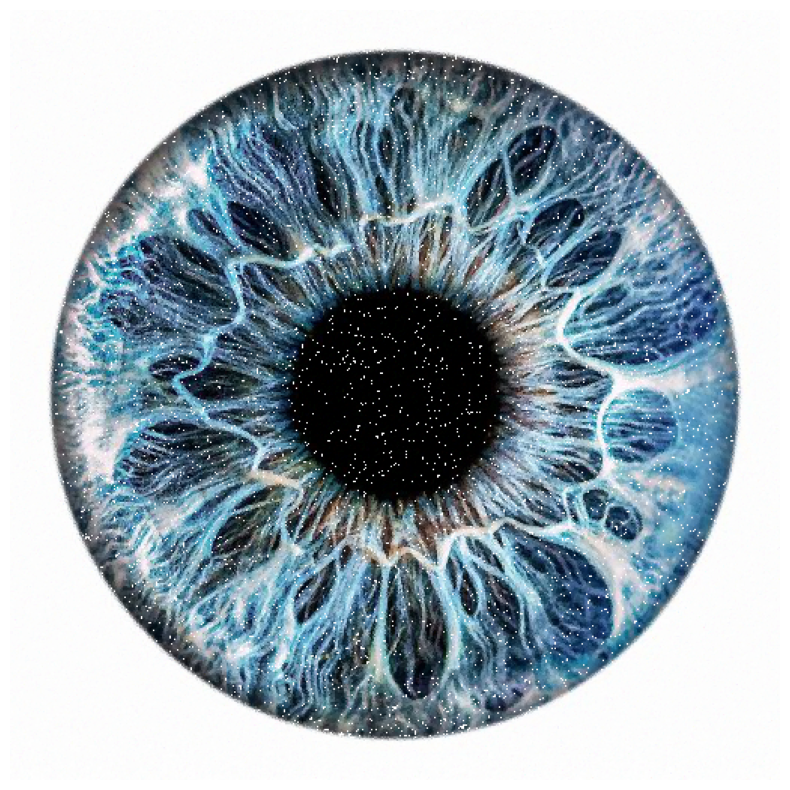

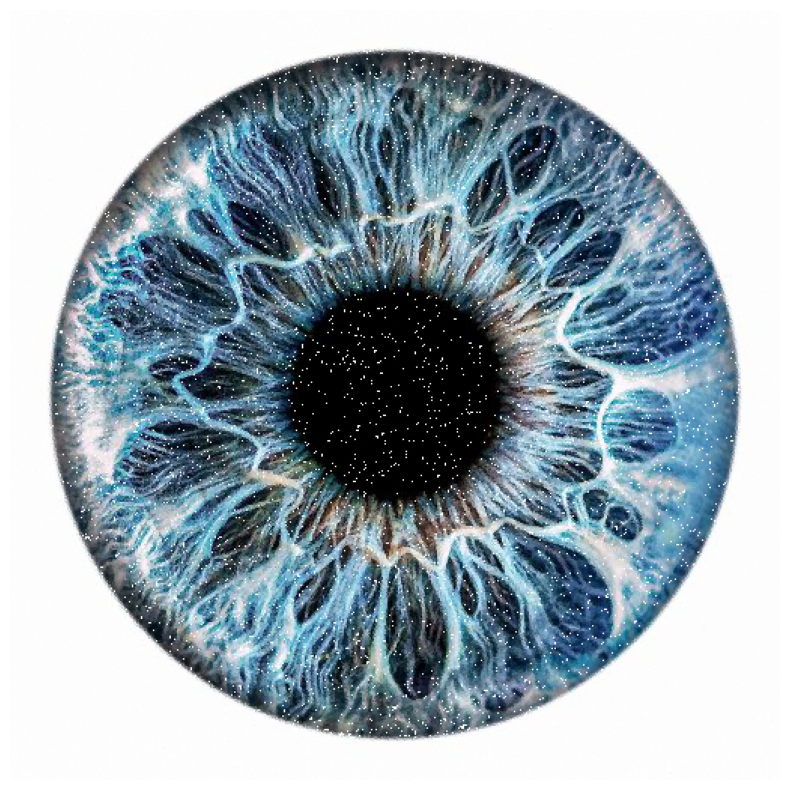

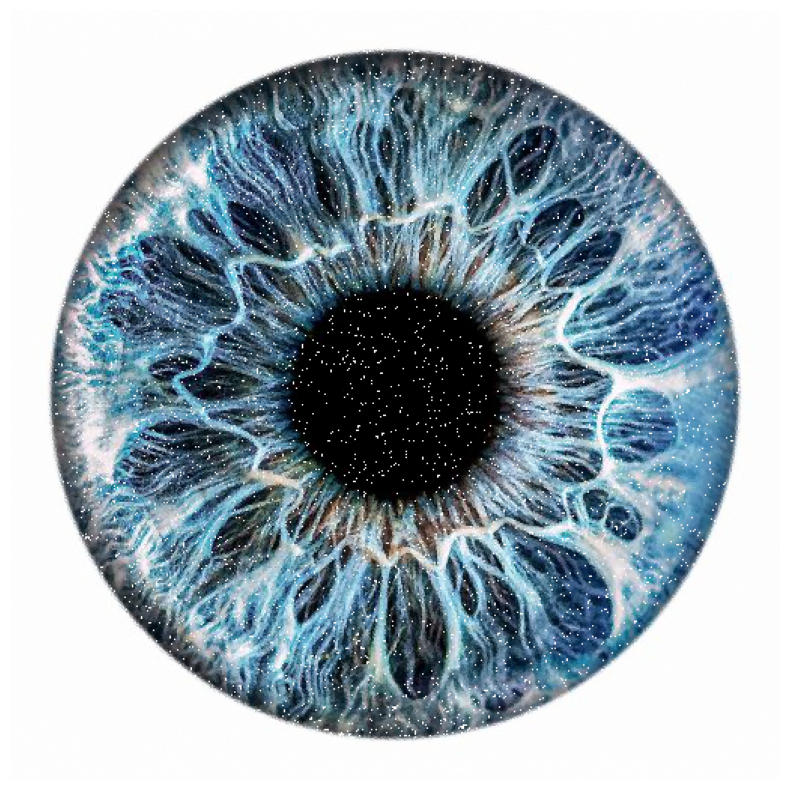

In [ ]:
optimizer = torch.optim.Adam([verts, rgb], lr=0.001)
loop = tqdm(range(2501))

for epoch in loop:
    # Initialize optimizer
    optimizer.zero_grad()

    point_cloud = Pointclouds(points=[verts], features=[rgb]).to(device)
    images = pcrenderer(point_cloud, gamma=(1e-4,),
                  bg_col=torch.tensor([1.0, 1.0, 1.0], dtype=torch.float32, device=device))

    loss = torch.sum((images - gt)**2) / len(images.view(-1))


    # Print the losses
    loop.set_description("total_loss = %.6f" % loss)

    # Plot mesh
    if epoch % 250 == 0:
        plt.figure(figsize=(10, 10))
        plt.imshow(images[0, ..., :3].detach().cpu().numpy())
        plt.grid("off")
        plt.axis("off");

    loss.backward()
    optimizer.step()